# Homework for Week4- Census Data Exploration 
## Chase Engelhardt
In this Assignment I'm going to build on some of the mapping I did in the last assignment and try to learn how to calculate a new variable. Shweta did some analysis on housing units per neighborhood and I am going to take that and compare it to the number of jobs per neighborhood. First seperately, then as a ratio. I'll take these three variables and create a folium map with them. 

### Importing and cleaning the Data

In [1]:
#import libraries
import pandas as pd
import geopandas as gpd
import fiona
import geopandas.geoseries 

ERROR 1: PROJ: proj_create_from_database: Open of /opt/conda/share/proj failed


In [2]:
#import csv files

#Housing units
housingdf = pd.read_csv('data/Total Housing Units - 2019.csv') 

#race
racedf=  pd.read_csv('data/Race.csv') 
#Jobs
jobsdf=  pd.read_csv('data/Total Jobs - 2019.csv') 


In [3]:
#relabel jobs data
jobsdf.rename(columns={'name':'Neighborhood', 'total_jobs_count':'Number of Jobs'},inplace=True)

In [4]:
#relabel housing data
housingdf.rename(columns={'name':'Neighborhood', 'housing_units_count':'Units of Housing'},inplace=True)

In [5]:
#Addressing the FIPS dilemma for the race data

In [6]:
racedf.Geo_FIPS.sample(10)

1939    6037570100
2047    6037577400
1687    6037532606
1354    6037408301
1957    6037570703
2005    6037574500
2232    6037670500
621     6037208902
571     6037204600
709     6037216800
Name: Geo_FIPS, dtype: int64

In [7]:
racedf = pd.read_csv(
    'data/Race.csv',
    dtype=
    {
        'Geo_FIPS':str,
        'Geo_STATE':str,
        'Geo_COUNTY': str
    }
)


In [8]:
#drop extra columns
racedf=racedf[['Geo_FIPS',
                   'SE_T028_000',       
                   'SE_T028_001',      
                   'SE_T028_002',    
                   'SE_T028_003',     
                   'SE_T028_004',  
                   'SE_T028_005',
                    'SE_T028_006',
                   'SE_T028_007', 
                   'SE_T028_008',
                  'SE_T028_009']] 
columns = list(racedf)

#rename the data after referencing data dictionary. 

racedf.columns = ['FIPS',
'Total Population',
'Hispanic',
'Non Hispanic',
'White',
'African American or Black',
'American Indian and Alaska Native',
'Asian',
'Native Hawaiian and Other Pacific Islander',
'Other',
'Two or more Races']

racedf.head()


,FIPS,Total Population,Hispanic,Non Hispanic,White,African American or Black,American Indian and Alaska Native,Asian,Native Hawaiian and Other Pacific Islander,Other,Two or more Races
0,06037101110,4926,1381,3545,2840,65,7,434,8,14,177
1,06037101122,3728,542,3186,2614,31,7,392,0,23,119
2,06037101220,3344,1081,2263,1751,34,4,352,0,21,101
3,06037101221,3444,1178,2266,1840,73,3,246,3,10,91
4,06037101222,2808,1040,1768,1455,76,3,148,0,8,78


In [9]:
#creating a loop to drop null columns (it wasn't working at first and then I realized I needed the inplace operator)
dflist=(housingdf,jobsdf,racedf)

for data in dflist:
    data.dropna(axis=1,how="all",inplace=True)
    data.info()

#my housing and jobs data were already clean but I wanted to try making a loop.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 257 entries, 0 to 256
Data columns (total 3 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Neighborhood      257 non-null    object 
 1   year              257 non-null    int64  
 2   Units of Housing  257 non-null    float64
dtypes: float64(1), int64(1), object(1)
memory usage: 6.1+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 257 entries, 0 to 256
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Neighborhood    257 non-null    object 
 1   year            257 non-null    int64  
 2   Number of Jobs  257 non-null    float64
dtypes: float64(1), int64(1), object(1)
memory usage: 6.1+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2498 entries, 0 to 2497
Data columns (total 11 columns):
 #   Column                                      Non-Null Count  Dtype 
---  ------                  

### Attaching geometries to the data

In [10]:
#Import census tracts and neighborhoods
nhoods=gpd.read_file('data/L.A. Neighborhoods.geojson')
tracts=gpd.read_file('data/Census_Tracts_2020.geojson')
nhoods1=gpd.read_file('data/Los Angeles Neighborhood Map.geojson')
nhtracts=gpd.read_file('data/Census_Tract_Locations__LA_.csv')
#rename 'name' to 'neighborhood'
nhoods.rename(columns={'name':'Neighborhood'},inplace=True)
nhoods1.head()

,external_i,name,location,latitude,slug_1,sqmi,display_na,set,slug,longitude,name_1,kind,type,geometry
0,acton,Acton,POINT(34.497355239240846 -118.16981019229348),-118.16981019229348,None,39.3391089485,Acton L.A. County Neighborhood (Current),L.A. County Neighborhoods (Current),acton,34.497355239240846,None,L.A. County Neighborhood (Current),unincorporated-area,"MULTIPOLYGON (((-118.20262 34.53899, -118.1894..."
1,adams-normandie,Adams-Normandie,POINT(34.031461499124156 -118.30020800000011),-118.30020800000011,None,0.805350187789,Adams-Normandie L.A. County Neighborhood (Curr...,L.A. County Neighborhoods (Current),adams-normandie,34.031461499124156,None,L.A. County Neighborhood (Current),segment-of-a-city,"MULTIPOLYGON (((-118.30901 34.03741, -118.3004..."
2,agoura-hills,Agoura Hills,POINT(34.146736499122795 -118.75988450000015),-118.75988450000015,None,8.14676029818,Agoura Hills L.A. County Neighborhood (Current),L.A. County Neighborhoods (Current),agoura-hills,34.146736499122795,None,L.A. County Neighborhood (Current),standalone-city,"MULTIPOLYGON (((-118.76193 34.16820, -118.7263..."
3,agua-dulce,Agua Dulce,POINT(34.504926999796837 -118.3171036690717),-118.3171036690717,None,31.4626319451,Agua Dulce L.A. County Neighborhood (Current),L.A. County Neighborhoods (Current),agua-dulce,34.504926999796837,None,L.A. County Neighborhood (Current),unincorporated-area,"MULTIPOLYGON (((-118.25468 34.55830, -118.2555..."
4,alhambra,Alhambra,POINT(34.085538999123571 -118.13651200000021),-118.13651200000021,None,7.62381430605,Alhambra L.A. County Neighborhood (Current),L.A. County Neighborhoods (Current),alhambra,34.085538999123571,None,L.A. County Neighborhood (Current),standalone-city,"MULTIPOLYGON (((-118.12175 34.10504, -118.1168..."


In [11]:
#merging race and census geomerty on FIPS 
# create a FIPS column
tracts['FIPS'] ='06' + '037' + tracts['CT20']
tracts.head()

,OBJECTID,CT20,LABEL,ShapeSTArea,ShapeSTLength,geometry,FIPS
0,1,101110,1011.10,1.229562e+07,15083.854287,"POLYGON ((-118.28491 34.25948, -118.28492 34.2...",06037101110
1,2,101122,1011.22,2.845774e+07,31671.455844,"POLYGON ((-118.29015 34.27417, -118.29015 34.2...",06037101122
2,3,101220,1012.20,7.522093e+06,12698.783810,"POLYGON ((-118.28100 34.25592, -118.28198 34.2...",06037101220
3,4,101221,1012.21,3.812000e+06,9161.710543,"POLYGON ((-118.28735 34.25591, -118.28863 34.2...",06037101221
4,5,101222,1012.22,3.191371e+06,9980.600461,"POLYGON ((-118.28594 34.25405, -118.28594 34.2...",06037101222


In [12]:
#add geometry to race data
racetracts=tracts.merge(racedf,on="FIPS")
racetracts.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2495 entries, 0 to 2494
Data columns (total 17 columns):
 #   Column                                      Non-Null Count  Dtype   
---  ------                                      --------------  -----   
 0   OBJECTID                                    2495 non-null   int64   
 1   CT20                                        2495 non-null   object  
 2   LABEL                                       2495 non-null   object  
 3   ShapeSTArea                                 2495 non-null   float64 
 4   ShapeSTLength                               2495 non-null   float64 
 5   geometry                                    2495 non-null   geometry
 6   FIPS                                        2495 non-null   object  
 7   Total Population                            2495 non-null   int64   
 8   Hispanic                                    2495 non-null   int64   
 9   Non Hispanic                                2495 non-null   int64 

In [13]:
#Merge and add geometry to housing and Jobs data
hjmerge=housingdf.merge(jobsdf,on="Neighborhood")
housingjobs=hjmerge.merge(nhoods,on="Neighborhood")
housingjobs.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 256 entries, 0 to 255
Data columns (total 13 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   Neighborhood      256 non-null    object  
 1   year_x            256 non-null    int64   
 2   Units of Housing  256 non-null    float64 
 3   year_y            256 non-null    int64   
 4   Number of Jobs    256 non-null    float64 
 5   description       256 non-null    object  
 6   set               256 non-null    object  
 7   slug              256 non-null    object  
 8   square_miles      256 non-null    object  
 9   region            256 non-null    object  
 10  type              256 non-null    object  
 11  source_link       256 non-null    object  
 12  geometry          256 non-null    geometry
dtypes: float64(2), geometry(1), int64(2), object(8)
memory usage: 28.0+ KB


In [14]:
#adding a column that expresses jobs to housing as a ratio
housingjobs['Number of Jobs Per Unit of Housing'] = housingjobs['Number of Jobs']/housingjobs['Units of Housing']
housingjobs.head()

,Neighborhood,year_x,Units of Housing,year_y,Number of Jobs,description,set,slug,square_miles,region,type,source_link,geometry,Number of Jobs Per Unit of Housing
0,Irwindale,2019,518.24,2019,16484.74,Irwindale is a city in the San Gabriel Valley ...,L.A. County Neighborhoods (Current),irwindale,9.58225973628,San Gabriel Valley,standalone-city,http://maps.latimes.com/neighborhoods/neighbor...,"MULTIPOLYGON (((-117.92940 34.14013, -117.9295...",31.809085
1,Pico-Union,2019,13618.70,2019,10516.11,Pico-Union is a neighborhood in the city of Lo...,L.A. County Neighborhoods (Current),pico-union,1.66946888734,Central L.A.,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,"MULTIPOLYGON (((-118.29691 34.05291, -118.2927...",0.772182
2,Glendora,2019,18158.15,2019,21029.55,Glendora is a city in the San Gabriel Valley r...,L.A. County Neighborhoods (Current),glendora,19.5413403615,San Gabriel Valley,standalone-city,http://maps.latimes.com/neighborhoods/neighbor...,"MULTIPOLYGON (((-117.82408 34.17861, -117.7936...",1.158133
3,Industry,2019,6227.91,2019,60379.18,Industry is a city in the San Gabriel Valley r...,L.A. County Neighborhoods (Current),industry,12.3503569476,San Gabriel Valley,standalone-city,http://maps.latimes.com/neighborhoods/neighbor...,"MULTIPOLYGON (((-117.88393 33.99597, -117.8839...",9.694935
4,Sylmar,2019,22156.30,2019,20444.10,Sylmar is a neighborhood in the city of Los An...,L.A. County Neighborhoods (Current),sylmar,12.4563875325,San Fernando Valley,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,"MULTIPOLYGON (((-118.43628 34.32990, -118.4199...",0.922722


### Mapping and spatial Joins

In [15]:
#import folium and plotly
import folium
import plotly.express as px

In [16]:
#convert housing jobs data to gdf
gdf = gpd.GeoDataFrame(
    housingjobs,crs=4326)

In [17]:
#merge with city of LA Boundary
zipfile = "data/City_Boundary.zip"
city = geopandas.read_file(zipfile)
finalgdf= city.overlay(gdf, how='intersection')
finalgdf.info()
finalgdf.to_json

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 152 entries, 0 to 151
Data columns (total 16 columns):
 #   Column                              Non-Null Count  Dtype   
---  ------                              --------------  -----   
 0   OBJECTID                            152 non-null    int64   
 1   CITY                                152 non-null    object  
 2   Neighborhood                        152 non-null    object  
 3   year_x                              152 non-null    int64   
 4   Units of Housing                    152 non-null    float64 
 5   year_y                              152 non-null    int64   
 6   Number of Jobs                      152 non-null    float64 
 7   description                         152 non-null    object  
 8   set                                 152 non-null    object  
 9   slug                                152 non-null    object  
 10  square_miles                        152 non-null    object  
 11  region                  

<bound method GeoDataFrame.to_json of      OBJECTID CITY             Neighborhood  year_x  Units of Housing  year_y  \
0           1   IN               Pico-Union    2019          13618.70    2019   
1           1   IN                   Sylmar    2019          22156.30    2019   
2           1   IN                 Torrance    2019          57909.46    2019   
3           1   IN                 Alhambra    2019          31641.86    2019   
4           1   IN              North Hills    2019          17637.30    2019   
..        ...  ...                      ...     ...               ...     ...   
147         1   IN                  Carthay    2019           2766.49    2019   
148         1   IN            Beverly Hills    2019          17533.62    2019   
149         1   IN               El Segundo    2019           6763.60    2019   
150         1   IN  View Park-Windsor Hills    2019           5126.73    2019   
151         1   IN            Gramercy Park    2019           4411.11  

In [18]:
#realizing that the projections must be off because I got some neighborhoods not in the city of LA
sorted1=finalgdf.sort_values(by='Number of Jobs Per Unit of Housing', ascending=False,)
sorted1.head(10)


,OBJECTID,CITY,Neighborhood,year_x,Units of Housing,year_y,Number of Jobs,description,set,slug,square_miles,region,type,source_link,Number of Jobs Per Unit of Housing,geometry
26,1,IN,Vernon,2019,112.28,2019,39801.81,Vernon is a city in the Southeast region of Lo...,L.A. County Neighborhoods (Current),vernon,5.22380283359,Southeast,standalone-city,http://maps.latimes.com/neighborhoods/neighbor...,354.487086,"MULTIPOLYGON (((-118.20504 34.01263, -118.2053..."
13,1,IN,Veterans Administration,2019,178.87,2019,9285.28,Veterans Administration is an unincorporated a...,L.A. County Neighborhoods (Current),veterans-administration,0.911282077501,Westside,unincorporated-area,http://maps.latimes.com/neighborhoods/neighbor...,51.910773,"MULTIPOLYGON (((-118.45283 34.06351, -118.4541..."
134,1,IN,Universal City,2019,79.37,2019,2151.03,Universal City is an unincorporated area in th...,L.A. County Neighborhoods (Current),universal-city,0.48037127178,San Fernando Valley,unincorporated-area,http://maps.latimes.com/neighborhoods/neighbor...,27.101298,"MULTIPOLYGON (((-118.34842 34.13199, -118.3486..."
114,1,IN,Century City,2019,3738.48,2019,65122.54,Century City is a neighborhood in the city of ...,L.A. County Neighborhoods (Current),century-city,0.700611362635,Westside,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,17.419523,"POLYGON ((-118.41438 34.06437, -118.41408 34.0..."
20,1,IN,Commerce,2019,3665.68,2019,53378.46,Commerce is a city in the Southeast region of ...,L.A. County Neighborhoods (Current),commerce,6.58056684961,Southeast,standalone-city,http://maps.latimes.com/neighborhoods/neighbor...,14.561680,"MULTIPOLYGON (((-118.19143 34.01286, -118.1914..."
149,1,IN,El Segundo,2019,6763.60,2019,73704.28,El Segundo is a city in the South Bay region o...,L.A. County Neighborhoods (Current),el-segundo,5.45900812963,South Bay,standalone-city,http://maps.latimes.com/neighborhoods/neighbor...,10.897197,"MULTIPOLYGON (((-118.37874 33.92901, -118.3787..."
54,1,IN,Downtown,2019,36154.32,2019,335257.20,Downtown is a neighborhood in the city of Los ...,L.A. County Neighborhoods (Current),downtown,5.83816978008,Central L.A.,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,9.272950,"POLYGON ((-118.22323 34.01495, -118.22339 34.0..."
63,1,IN,Burbank,2019,43784.47,2019,260490.14,Burbank is a city in the San Fernando Valley r...,L.A. County Neighborhoods (Current),burbank,17.3418424792,San Fernando Valley,standalone-city,http://maps.latimes.com/neighborhoods/neighbor...,5.949373,"MULTIPOLYGON (((-118.31033 34.16077, -118.3096..."
111,1,IN,West Compton,2019,1986.30,2019,9567.07,West Compton is an unincorporated area in the ...,L.A. County Neighborhoods (Current),west-compton,1.65436407239,Southeast,unincorporated-area,http://maps.latimes.com/neighborhoods/neighbor...,4.816528,"POLYGON ((-118.28228 33.89720, -118.28312 33.8..."
106,1,IN,Westchester,2019,17434.97,2019,80734.38,Westchester is a neighborhood in the city of L...,L.A. County Neighborhoods (Current),westchester,10.8092117067,South Bay,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,4.630600,"POLYGON ((-118.35855 33.98167, -118.35867 33.9..."


In [19]:
#dropping them 
oopsies=['Burbank','Commerce','El Segundo','Vernon','Universal City','Veterans Administration','West Compton']
for value in oopsies:
    finalgdf = finalgdf[finalgdf.Neighborhood != value]
sorted1=finalgdf.sort_values(by='Number of Jobs Per Unit of Housing', ascending=False,)
sorted1.head(10)

,OBJECTID,CITY,Neighborhood,year_x,Units of Housing,year_y,Number of Jobs,description,set,slug,square_miles,region,type,source_link,Number of Jobs Per Unit of Housing,geometry
114,1,IN,Century City,2019,3738.48,2019,65122.54,Century City is a neighborhood in the city of ...,L.A. County Neighborhoods (Current),century-city,0.700611362635,Westside,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,17.419523,"POLYGON ((-118.41438 34.06437, -118.41408 34.0..."
54,1,IN,Downtown,2019,36154.32,2019,335257.20,Downtown is a neighborhood in the city of Los ...,L.A. County Neighborhoods (Current),downtown,5.83816978008,Central L.A.,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,9.272950,"POLYGON ((-118.22323 34.01495, -118.22339 34.0..."
106,1,IN,Westchester,2019,17434.97,2019,80734.38,Westchester is a neighborhood in the city of L...,L.A. County Neighborhoods (Current),westchester,10.8092117067,South Bay,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,4.630600,"POLYGON ((-118.35855 33.98167, -118.35867 33.9..."
132,1,IN,Westwood,2019,21145.86,2019,87728.27,Westwood is a neighborhood in the city of Los ...,L.A. County Neighborhoods (Current),westwood,3.6757772963,Westside,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,4.148721,"POLYGON ((-118.42324 34.07993, -118.42384 34.0..."
118,1,IN,West Los Angeles,2019,6318.91,2019,24877.53,West Los Angeles is a neighborhood in the city...,L.A. County Neighborhoods (Current),west-los-angeles,1.04957313159,Westside,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,3.936997,"POLYGON ((-118.43504 34.03693, -118.44438 34.0..."
25,1,IN,Culver City,2019,15913.37,2019,58109.83,Culver City is a city in the Westside region o...,L.A. County Neighborhoods (Current),culver-city,5.19276111048,Westside,standalone-city,http://maps.latimes.com/neighborhoods/neighbor...,3.651636,"MULTIPOLYGON (((-118.37697 34.02375, -118.3768..."
137,1,IN,Ladera Heights,2019,5811.85,2019,20017.43,Ladera Heights is an unincorporated area in th...,L.A. County Neighborhoods (Current),ladera-heights,2.93973763627,Westside,unincorporated-area,http://maps.latimes.com/neighborhoods/neighbor...,3.444244,"MULTIPOLYGON (((-118.35812 33.99739, -118.3583..."
148,1,IN,Beverly Hills,2019,17533.62,2019,56234.90,Beverly Hills is a city in the Westside region...,L.A. County Neighborhoods (Current),beverly-hills,5.70224133167,Westside,standalone-city,http://maps.latimes.com/neighborhoods/neighbor...,3.207261,"MULTIPOLYGON (((-118.37718 34.05953, -118.3760..."
147,1,IN,Carthay,2019,2766.49,2019,7745.71,Carthay is a neighborhood in the city of Los A...,L.A. County Neighborhoods (Current),carthay,0.504675757272,Central L.A.,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,2.799833,"POLYGON ((-118.36151 34.06301, -118.36381 34.0..."
40,1,IN,Carson,2019,25667.23,2019,64857.22,Carson is a city in the Harbor region of Los A...,L.A. County Neighborhoods (Current),carson,19.1495884923,Harbor,standalone-city,http://maps.latimes.com/neighborhoods/neighbor...,2.526849,"MULTIPOLYGON (((-118.22395 33.80622, -118.2239..."


In [20]:
#super proud of that loop, but now realizing that I still have other cities in the data, so new idea
finalgdf.drop(finalgdf[finalgdf['type'] != 'segment-of-a-city'].index, inplace = True)
sorted1=finalgdf.sort_values(by='Number of Jobs Per Unit of Housing', ascending=False,)
sorted1.head(10)

,OBJECTID,CITY,Neighborhood,year_x,Units of Housing,year_y,Number of Jobs,description,set,slug,square_miles,region,type,source_link,Number of Jobs Per Unit of Housing,geometry
114,1,IN,Century City,2019,3738.48,2019,65122.54,Century City is a neighborhood in the city of ...,L.A. County Neighborhoods (Current),century-city,0.700611362635,Westside,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,17.419523,"POLYGON ((-118.41438 34.06437, -118.41408 34.0..."
54,1,IN,Downtown,2019,36154.32,2019,335257.20,Downtown is a neighborhood in the city of Los ...,L.A. County Neighborhoods (Current),downtown,5.83816978008,Central L.A.,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,9.272950,"POLYGON ((-118.22323 34.01495, -118.22339 34.0..."
106,1,IN,Westchester,2019,17434.97,2019,80734.38,Westchester is a neighborhood in the city of L...,L.A. County Neighborhoods (Current),westchester,10.8092117067,South Bay,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,4.630600,"POLYGON ((-118.35855 33.98167, -118.35867 33.9..."
132,1,IN,Westwood,2019,21145.86,2019,87728.27,Westwood is a neighborhood in the city of Los ...,L.A. County Neighborhoods (Current),westwood,3.6757772963,Westside,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,4.148721,"POLYGON ((-118.42324 34.07993, -118.42384 34.0..."
118,1,IN,West Los Angeles,2019,6318.91,2019,24877.53,West Los Angeles is a neighborhood in the city...,L.A. County Neighborhoods (Current),west-los-angeles,1.04957313159,Westside,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,3.936997,"POLYGON ((-118.43504 34.03693, -118.44438 34.0..."
147,1,IN,Carthay,2019,2766.49,2019,7745.71,Carthay is a neighborhood in the city of Los A...,L.A. County Neighborhoods (Current),carthay,0.504675757272,Central L.A.,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,2.799833,"POLYGON ((-118.36151 34.06301, -118.36381 34.0..."
139,1,IN,Beverly Grove,2019,13138.59,2019,32281.72,Beverly Grove is a neighborhood in the city of...,L.A. County Neighborhoods (Current),beverly-grove,1.64868313332,Central L.A.,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,2.457016,"POLYGON ((-118.37388 34.06689, -118.37586 34.0..."
41,1,IN,Hollywood Hills,2019,13688.68,2019,33623.05,Hollywood Hills is a neighborhood in the city ...,L.A. County Neighborhoods (Current),hollywood-hills,7.04764074288,Central L.A.,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,2.456267,"POLYGON ((-118.32908 34.15017, -118.32904 34.1..."
5,1,IN,Harbor Gateway,2019,13329.57,2019,31028.04,Harbor Gateway is a neighborhood in the city o...,L.A. County Neighborhoods (Current),harbor-gateway,5.14092312531,Harbor,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,2.327760,"POLYGON ((-118.28141 33.92320, -118.28146 33.9..."
39,1,IN,Playa Vista,2019,7065.80,2019,16325.83,Playa Vista is a neighborhood in the city of L...,L.A. County Neighborhoods (Current),playa-vista,1.29929176452,Westside,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,2.310542,"POLYGON ((-118.39585 33.98490, -118.39568 33.9..."


In [21]:
#cloropleth map of jobs and housing 
import branca
m = folium.Map(location=[34.0522, -118.2437], zoom_start=10)

#Ratio layer
folium.Choropleth(
    geo_data=finalgdf,
    name="Number of Jobs Per Unit of Housing",
    data=finalgdf,
    columns=["Neighborhood","Number of Jobs Per Unit of Housing"],
    key_on="feature.properties.Neighborhood",
    fill_color="BuPu",
    fill_opacity=0.9,
    line_opacity=0.2,
    legend_name="Jobs to Housing",

).add_to(m)
#housing layer
folium.Choropleth(
    geo_data=finalgdf,
    name="Housing Units",
    data=finalgdf,
    columns=["Neighborhood","Units of Housing"],
    key_on="feature.properties.Neighborhood",
    fill_color="BuPu",
    fill_opacity=0.9,
    line_opacity=0.2,
    legend_name="Housing Units",
).add_to(m)
#jobs layer
folium.Choropleth(
    geo_data=finalgdf,
    name="Number of Jobs",
    data=finalgdf,
    columns=["Neighborhood","Number of Jobs"],
    key_on="feature.properties.Neighborhood",
    fill_color="BuPu",
    fill_opacity=0.9,
    line_opacity=0.2,
    legend_name="Jobs",
).add_to(m)


#note for self/classmates: 'key_on'requires a "feature.properties." argument before the index you want to reference 

folium.LayerControl().add_to(m)

m

### Plotting it 

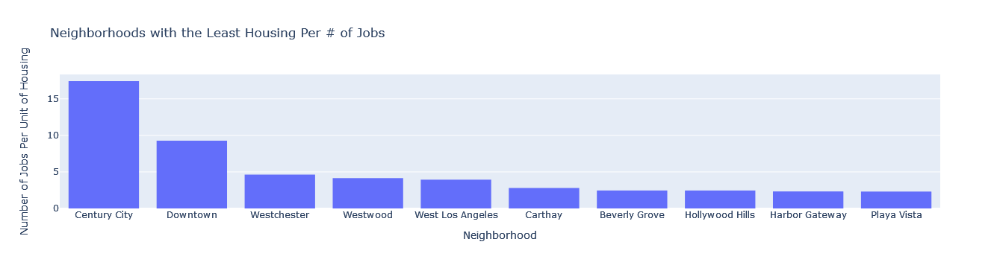

In [22]:
#since we have some outlier neighborhoods (yikes, century city), it's not so satisfying on a map, and I don't know how to map quantiles in python. So lets make a plot 
fig = px.bar(sorted1.head(10),
       x='Neighborhood', 
        y= 'Number of Jobs Per Unit of Housing',
       title='Neighborhoods with the Least Housing Per # of Jobs'

      )

# get rid of white lines inside the bars
fig.update_traces(marker_line_width=0)

# show the figure
fig.show()

### Using Quantiles 

In [23]:
#since the map wasn't visually very helpful I decided to research how to divide my data into quantiles 
import numpy as np
import seaborn as sns
finalgdf['Jobs to Housing Quantiles'] = pd.qcut(finalgdf['Number of Jobs Per Unit of Housing'],
                              q=5,
                              labels=False)
finalgdf.head(7)

,OBJECTID,CITY,Neighborhood,year_x,Units of Housing,year_y,Number of Jobs,description,set,slug,square_miles,region,type,source_link,Number of Jobs Per Unit of Housing,geometry,Jobs to Housing Quantiles
0,1,IN,Pico-Union,2019,13618.70,2019,10516.11,Pico-Union is a neighborhood in the city of Lo...,L.A. County Neighborhoods (Current),pico-union,1.66946888734,Central L.A.,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,0.772182,"POLYGON ((-118.29271 34.05291, -118.29161 34.0...",2
1,1,IN,Sylmar,2019,22156.30,2019,20444.10,Sylmar is a neighborhood in the city of Los An...,L.A. County Neighborhoods (Current),sylmar,12.4563875325,San Fernando Valley,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,0.922722,"POLYGON ((-118.41998 34.32917, -118.41998 34.3...",3
4,1,IN,North Hills,2019,17637.30,2019,9615.66,North Hills is a neighborhood in the city of L...,L.A. County Neighborhoods (Current),north-hills,5.30811801222,San Fernando Valley,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,0.545189,"POLYGON ((-118.47202 34.25720, -118.47203 34.2...",1
5,1,IN,Harbor Gateway,2019,13329.57,2019,31028.04,Harbor Gateway is a neighborhood in the city o...,L.A. County Neighborhoods (Current),harbor-gateway,5.14092312531,Harbor,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,2.327760,"POLYGON ((-118.28141 33.92320, -118.28146 33.9...",4
7,1,IN,Lake Balboa,2019,9621.27,2019,10142.76,Lake Balboa is a neighborhood in the city of L...,L.A. County Neighborhoods (Current),lake-balboa,3.12585429603,San Fernando Valley,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,1.054202,"POLYGON ((-118.50102 34.21540, -118.50092 34.2...",3
8,1,IN,Granada Hills,2019,18161.58,2019,11503.87,Granada Hills is a neighborhood in the city of...,L.A. County Neighborhoods (Current),granada-hills,15.1114320603,San Fernando Valley,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,0.633418,"POLYGON ((-118.47992 34.30320, -118.47282 34.2...",2
9,1,IN,Palms,2019,22173.63,2019,11260.00,Palms is a neighborhood in the city of Los Ang...,L.A. County Neighborhoods (Current),palms,1.94535901621,Westside,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,0.507810,"POLYGON ((-118.38777 34.02907, -118.38817 34.0...",1


In [24]:
#now that I  have a quantile column I should be able to do the same map more effectively
m = folium.Map(location=[34.0522, -118.2437], zoom_start=10)

#Ratio layer
jm=folium.Choropleth(
    geo_data=finalgdf,
    name="Number of Jobs Per Unit of Housing",
    data=finalgdf,
    columns=["Neighborhood","Jobs to Housing Quantiles"],
    key_on="feature.properties.Neighborhood",
    fill_color="BuPu",
    fill_opacity=0.9,
    line_opacity=0.2,
    legend_name="Jobs to Housing Quantiles",
    

).add_to(m)


folium.LayerControl().add_to(m)

m

### Using Dissolve to Approximate Race Data By Neighborhood

In [25]:
#first we need to associate each tract with a neighborhood

#overlay to cut tracts not in the city of LA
laracetracts = racetracts.overlay(city, how='intersection')

#spatial join tracts with neighborhoods
join_inner_df = laracetracts.sjoin(nhoods, how="inner")
join_inner_df.head()

#approximate average for race in neighborhoods 
nhrace= join_inner_df.dissolve(by='Neighborhood', aggfunc='mean')
nhrace.head()

#correcting total population 36861
totpop=join_inner_df.dissolve(by='Neighborhood', aggfunc='sum')
nhrace['Total Population']=totpop['Total Population']
nhrace.sample(10)

/opt/conda/lib/python3.10/site-packages/geopandas/geodataframe.py:1676: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/opt/conda/lib/python3.10/site-packages/geopandas/geodataframe.py:1676: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



,geometry,OBJECTID_1,ShapeSTArea,ShapeSTLength,Total Population,Hispanic,Non Hispanic,White,African American or Black,American Indian and Alaska Native,Asian,Native Hawaiian and Other Pacific Islander,Other,Two or more Races,OBJECTID_2,index_right
Neighborhood,,,,,,,,,,,,,,,,
South Park,"POLYGON ((-118.28215 33.98237, -118.28268 33.9...",815.266667,5.462671e+06,9596.073782,64282,3587.800000,697.666667,53.066667,538.800000,6.333333,27.066667,2.400000,29.066667,40.933333,1.0,176.0
Mid-Wilshire,"POLYGON ((-118.35153 34.04513, -118.35222 34.0...",696.000000,7.040922e+06,11215.066391,77961,558.440000,2560.000000,1438.640000,338.080000,4.680000,571.480000,2.240000,31.440000,173.440000,1.0,24.0
Porter Ranch,"POLYGON ((-118.57092 34.25000, -118.57121 34.2...",203.578947,5.706488e+07,29737.904910,71590,736.736842,3031.157895,1719.578947,137.473684,5.368421,990.052632,4.684211,23.789474,150.210526,1.0,229.0
Sepulveda Basin,"POLYGON ((-118.46828 34.15416, -118.46824 34.1...",590.000000,2.619814e+07,22576.426379,32872,790.750000,3318.250000,2543.500000,188.625000,4.500000,333.125000,2.875000,29.500000,216.125000,1.0,166.0
Exposition Park,"POLYGON ((-118.30047 34.00370, -118.30077 34.0...",783.142857,5.682505e+06,10120.604454,78871,2319.380952,1436.380952,301.285714,710.523810,6.571429,290.095238,3.380952,26.809524,97.714286,1.0,200.0
Florence,"MULTIPOLYGON (((-118.27170 33.95557, -118.2717...",939.500000,5.802581e+06,10311.721113,98930,3254.125000,867.958333,45.000000,724.000000,4.958333,14.583333,3.666667,25.541667,50.208333,1.0,58.0
Mount Washington,"POLYGON ((-118.21956 34.08678, -118.21990 34.0...",429.583333,9.526805e+06,15983.461286,35044,1507.166667,1413.166667,750.666667,59.583333,4.833333,472.083333,1.750000,14.250000,110.000000,1.0,131.0
Century City,"POLYGON ((-118.41268 34.03116, -118.41308 34.0...",1148.714286,1.430169e+07,17665.147273,27394,316.857143,3596.571429,2839.571429,81.142857,3.142857,429.857143,2.428571,31.285714,209.142857,1.0,233.0
University Park,"POLYGON ((-118.27816 34.02081, -118.27902 34.0...",761.750000,5.368963e+06,10086.623161,37523,1451.333333,1675.583333,627.750000,278.666667,8.666667,665.000000,6.666667,17.250000,71.583333,1.0,86.0


### Mapping and Plotting Race By Neighborhood 

In [26]:
# convert the df to gdf
nhracegdf = gpd.GeoDataFrame(
    nhrace,crs=4326)
nhracegdf.head()
#had to copy index into a column
nhracegdf['Neighborhood']=nhracegdf.index
nhracegdf.drop(['OBJECTID_1','ShapeSTArea', 'ShapeSTLength','OBJECTID_2',],axis=1, inplace=True)
nhracegdf.head()

,geometry,Total Population,Hispanic,Non Hispanic,White,African American or Black,American Indian and Alaska Native,Asian,Native Hawaiian and Other Pacific Islander,Other,Two or more Races,index_right,Neighborhood
Neighborhood,,,,,,,,,,,,,
Adams-Normandie,"POLYGON ((-118.29915 34.02552, -118.30022 34.0...",36861,1955.363636,1395.636364,345.818182,532.636364,5.454545,394.272727,3.090909,22.272727,92.090909,126.0,Adams-Normandie
Alhambra,"POLYGON ((-118.16587 34.06230, -118.16607 34.0...",29328,2716.857143,1472.857143,377.142857,107.142857,11.000000,878.571429,2.571429,21.142857,75.285714,159.0,Alhambra
Arleta,"POLYGON ((-118.43910 34.23353, -118.44043 34.2...",56835,2834.214286,1225.428571,633.714286,54.071429,6.500000,465.214286,3.142857,14.428571,48.357143,161.0,Arleta
Arlington Heights,"POLYGON ((-118.32968 34.03514, -118.32973 34.0...",43166,1641.538462,1678.923077,333.769231,460.692308,5.307692,758.307692,1.615385,23.076923,96.153846,252.0,Arlington Heights
Athens,"POLYGON ((-118.29164 33.91542, -118.29164 33.9...",26709,2114.428571,1701.142857,74.857143,1398.142857,6.714286,85.142857,13.285714,26.714286,96.285714,236.0,Athens


In [27]:
#map it
#loop to plug race into layers
m2 = folium.Map(location=[34.0522, -118.2437], zoom_start=10)
racelist=['Hispanic', 'Non Hispanic','White','African American or Black', 'American Indian and Alaska Native', 'Asian', 'Native Hawaiian and Other Pacific Islander', 'Other','Two or more Races']
for race in racelist:
    folium.Choropleth(
        geo_data=nhracegdf,
        name="Population By Race-"+race,
        data=nhracegdf,
        columns=[nhracegdf.index,race],
        key_on="feature.properties.Neighborhood",
        fill_color="BuPu",
        fill_opacity=0.9,
        line_opacity=0.2,
        legend_name="Population-"+race,
    ).add_to(m2)

    
folium.LayerControl().add_to(m2)
m2

In [28]:
#you can see that the spatial join did not work out completely as planned so I'll have to continue to investigate how to best dissolve smaller geographies into larger ones next week.

### Graphing Race in Low-Housing, Job Rich Neighborhoods 

In [57]:
#Join race data with jobs/housing data
finalgdf['Merge']=finalgdf['Neighborhood']
nhracegdf['Merge']=nhracegdf['Neighborhood']
mergedstats=finalgdf.merge(nhracegdf, on='Merge')
mergedstats.head()
#drop unwanted colums
mergedstats.drop(columns=['Neighborhood_y','index_right','year_x','year_y','description','CITY','OBJECTID'],inplace=True)
#rename Neighborhood and set as index
mergedstats.rename(columns={'Neighborhood_x':'Neighborhood'},inplace=True)
mergedstats.set_index('Neighborhood')



,Units of Housing,Number of Jobs,set,slug,square_miles,region,type,source_link,Number of Jobs Per Unit of Housing,geometry_x,...,Total Population,Hispanic,Non Hispanic,White,African American or Black,American Indian and Alaska Native,Asian,Native Hawaiian and Other Pacific Islander,Other,Two or more Races
Neighborhood,,,,,,,,,,,,,,,,,,,,,
Pico-Union,13618.70,10516.11,L.A. County Neighborhoods (Current),pico-union,1.66946888734,Central L.A.,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,0.772182,"POLYGON ((-118.29271 34.05291, -118.29161 34.0...",...,75148,2226.666667,904.500000,175.666667,158.458333,4.666667,503.166667,1.750000,17.458333,43.333333
Sylmar,22156.30,20444.10,L.A. County Neighborhoods (Current),sylmar,12.4563875325,San Fernando Valley,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,0.922722,"POLYGON ((-118.41998 34.32917, -118.41998 34.3...",...,123444,3368.482759,888.206897,488.379310,109.103448,10.896552,207.517241,1.965517,18.793103,51.551724
North Hills,17637.30,9615.66,L.A. County Neighborhoods (Current),north-hills,5.30811801222,San Fernando Valley,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,0.545189,"POLYGON ((-118.47202 34.25720, -118.47203 34.2...",...,121714,2494.200000,1562.933333,730.533333,156.700000,5.600000,560.000000,4.766667,25.700000,79.633333
Harbor Gateway,13329.57,31028.04,L.A. County Neighborhoods (Current),harbor-gateway,5.14092312531,Harbor,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,2.327760,"POLYGON ((-118.28141 33.92320, -118.28146 33.9...",...,118230,1894.066667,2046.933333,378.100000,683.633333,6.800000,810.066667,30.333333,22.333333,115.666667
Lake Balboa,9621.27,10142.76,L.A. County Neighborhoods (Current),lake-balboa,3.12585429603,San Fernando Valley,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,1.054202,"POLYGON ((-118.50102 34.21540, -118.50092 34.2...",...,39982,1601.000000,1730.833333,1129.250000,133.750000,2.916667,326.333333,1.666667,22.000000,114.916667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Beverly Grove,13138.59,32281.72,L.A. County Neighborhoods (Current),beverly-grove,1.64868313332,Central L.A.,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,2.457016,"POLYGON ((-118.37388 34.06689, -118.37586 34.0...",...,44894,337.785714,2868.928571,2304.642857,112.000000,3.785714,253.357143,3.285714,27.214286,164.642857
Vermont Vista,7856.81,2025.92,L.A. County Neighborhoods (Current),vermont-vista,1.64553261505,South L.A.,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,0.257855,"POLYGON ((-118.28081 33.95991, -118.28071 33.9...",...,58586,2615.142857,1569.571429,59.571429,1348.500000,7.142857,35.071429,7.785714,23.571429,87.928571
Hyde Park,14932.53,5475.25,L.A. County Neighborhoods (Current),hyde-park,2.88464641644,South L.A.,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,0.366666,"POLYGON ((-118.31774 33.97081, -118.31775 33.9...",...,80572,1697.600000,2331.000000,167.200000,1894.200000,7.600000,56.900000,3.650000,35.500000,165.950000


In [58]:
#Sort top ten neighborhoods for low housing and plot by race 
sorted2=mergedstats.sort_values(by='Number of Jobs Per Unit of Housing', ascending=False)
sorted2.head()

,Neighborhood,Units of Housing,Number of Jobs,set,slug,square_miles,region,type,source_link,Number of Jobs Per Unit of Housing,...,Total Population,Hispanic,Non Hispanic,White,African American or Black,American Indian and Alaska Native,Asian,Native Hawaiian and Other Pacific Islander,Other,Two or more Races
88,Century City,3738.48,65122.54,L.A. County Neighborhoods (Current),century-city,0.700611362635,Westside,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,17.419523,...,27394,316.857143,3596.571429,2839.571429,81.142857,3.142857,429.857143,2.428571,31.285714,209.142857
37,Downtown,36154.32,335257.20,L.A. County Neighborhoods (Current),downtown,5.83816978008,Central L.A.,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,9.272950,...,115260,1125.128205,1830.256410,657.666667,400.153846,12.538462,626.666667,5.128205,21.487179,106.615385
82,Westchester,17434.97,80734.38,L.A. County Neighborhoods (Current),westchester,10.8092117067,South Bay,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,4.630600,...,114276,1028.551724,2912.000000,1440.344828,725.448276,7.344828,453.448276,12.068966,32.931034,240.413793
101,Westwood,21145.86,87728.27,L.A. County Neighborhoods (Current),westwood,3.6757772963,Westside,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,4.148721,...,86538,333.142857,2757.500000,1788.071429,102.250000,6.142857,692.678571,3.714286,22.642857,142.000000
91,West Los Angeles,6318.91,24877.53,L.A. County Neighborhoods (Current),west-los-angeles,1.04957313159,Westside,segment-of-a-city,http://maps.latimes.com/neighborhoods/neighbor...,3.936997,...,31547,255.000000,2899.700000,2082.300000,64.100000,3.800000,515.100000,2.600000,19.100000,212.700000


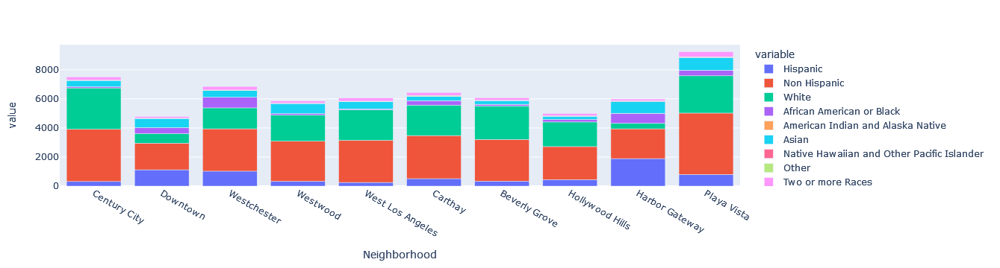

In [59]:
# make a stacked bar chart
fig = px.bar(sorted2.head(10),
       x='Neighborhood',
       y=racelist,
)

fig.show()

In [ ]:
#I'll also have to figure out how to solve for labeling "value". That said, here we can visualize and see that 8 of the top ten neighborhoods that have more hosuing than jobs are predominately White. 

In [ ]:
from IPython.display import FileLink, FileLinks

mergedstats.to_csv('data/mergedstats.csv', index=True)
